# **LAB - 11**

* Implement the concept of image alignment using OpenCV/PIL for the following process.
* Image realignment (point transformation (translation, rotation, scaling and also shearing),.
* Try to incorporate all the process related with image registration for any 5 medical images and 5 photo images of your choice.
* Display all the preprocessed images with original image. Make your comparison.

## **Image realignment**

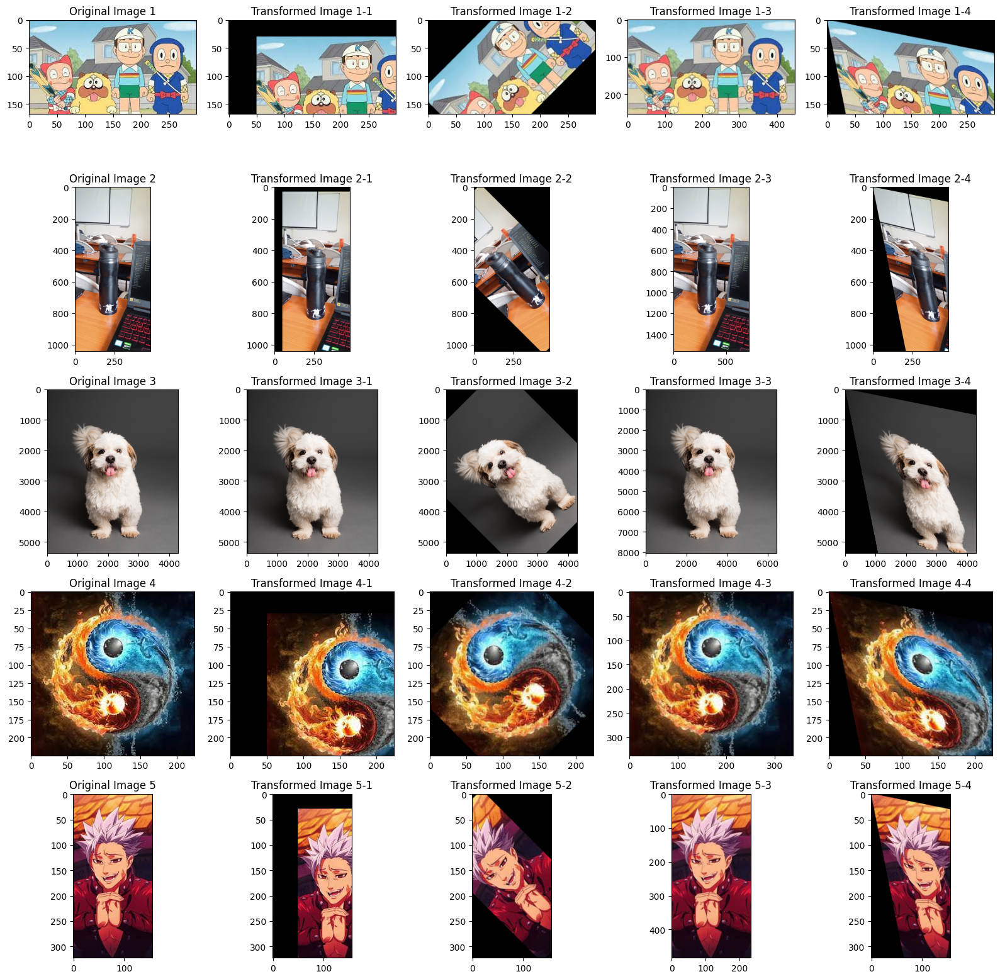

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Function to apply various point transformations
def apply_transformations(image):
    # Translation
    translation_matrix = np.float32([[1, 0, 50], [0, 1, 30]])
    translated_image = cv2.warpAffine(image, translation_matrix, (image.shape[1], image.shape[0]))

    # Rotation
    rotation_matrix = cv2.getRotationMatrix2D((image.shape[1] / 2, image.shape[0] / 2), 45, 1)
    rotated_image = cv2.warpAffine(image, rotation_matrix, (image.shape[1], image.shape[0]))

    # Scaling
    scaled_image = cv2.resize(image, None, fx=1.5, fy=1.5, interpolation=cv2.INTER_LINEAR)

    # Shearing
    shear_matrix = np.float32([[1, 0.2, 0], [0.2, 1, 0]])
    sheared_image = cv2.warpAffine(image, shear_matrix, (image.shape[1], image.shape[0]))

    return translated_image, rotated_image, scaled_image, sheared_image

# List of file paths for the images
image_paths = ['/content/ninja.jpg',
    '/content/a.jpeg',
    '/content/dog.jpg',
    '/content/image4.jpg',
    '/content/image5.jpg']

# Create a subplot for each image and its transformations
plt.figure(figsize=(16, 16))
for i, image_path in enumerate(image_paths):
    # Read the original image
    src = cv2.imread(image_path)

    # Apply various transformations q
    transformed_images = apply_transformations(src)

    # Display the original and transformed images side by side
    plt.subplot(5, 5, i * 5 + 1)
    plt.imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))
    plt.title(f'Original Image {i + 1}')

    for j, transformed_image in enumerate(transformed_images):
        plt.subplot(5, 5, i * 5 + j + 2)
        plt.imshow(cv2.cvtColor(transformed_image, cv2.COLOR_BGR2RGB))
        plt.title(f'Transformed Image {i + 1}-{j + 1}')

plt.tight_layout()
plt.show()



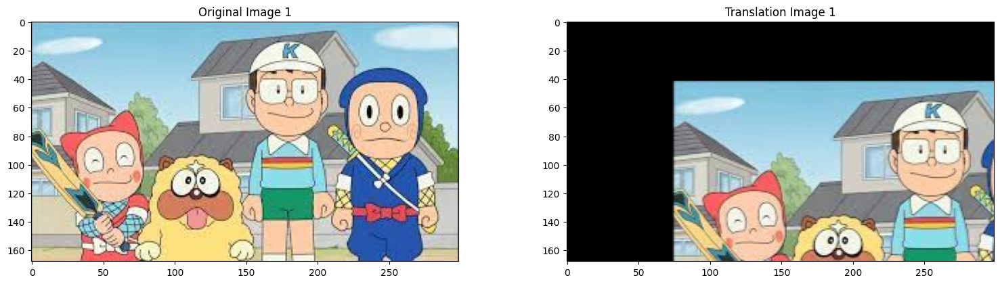

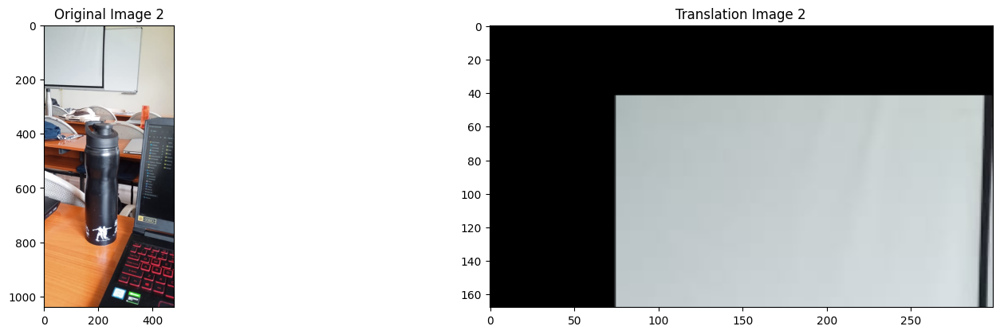

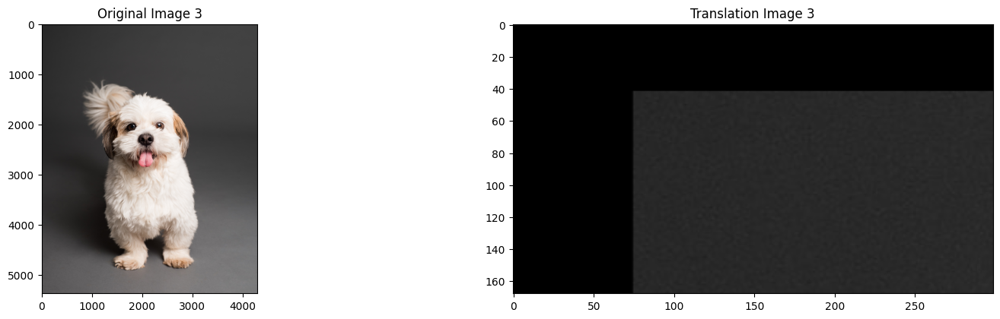

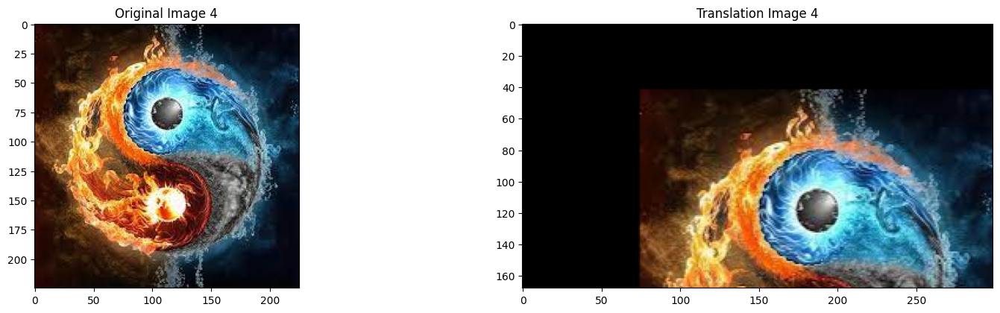

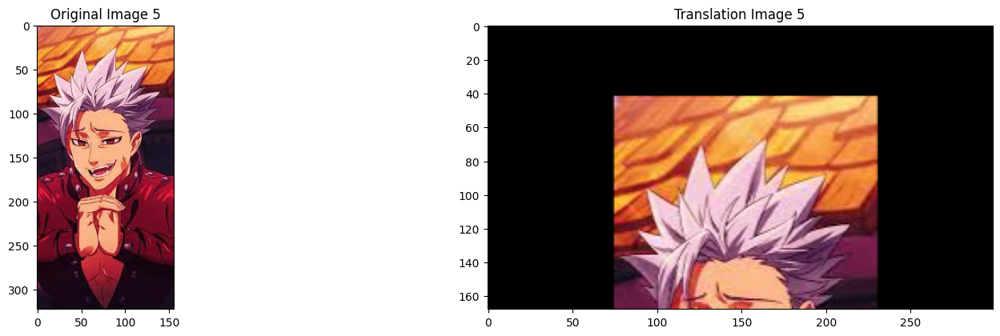

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load five images
image_paths = [    '/content/ninja.jpg',
    '/content/a.jpeg',
    '/content/dog.jpg',
    '/content/image4.jpg',
    '/content/image5.jpg']
images = [cv2.imread(path) for path in image_paths]

# Store height and width of the images
image_height, image_width, _ = images[0].shape
quarter_height, quarter_width = image_height / 4, image_width / 4

# Define the translation matrix
T = np.float32([[1, 0, quarter_width], [0, 1, quarter_height]])

# Create a subplot for displaying images

for i in range(5):
    plt.figure(figsize=(16, 8))

    plt.subplot(221)
    plt.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
    plt.title(f'Original Image {i + 1}')

    transformed_image = cv2.warpAffine(images[i], T, (image_width, image_height))
    plt.subplot(222)
    plt.imshow(cv2.cvtColor(transformed_image, cv2.COLOR_BGR2RGB))
    plt.title(f'Translation Image {i + 1}')

    plt.tight_layout()
    plt.show()


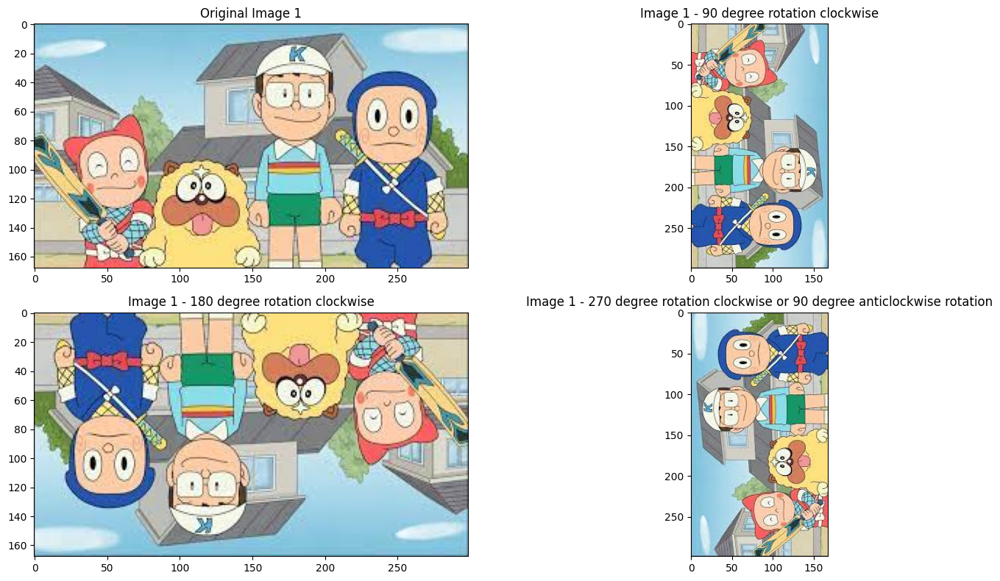

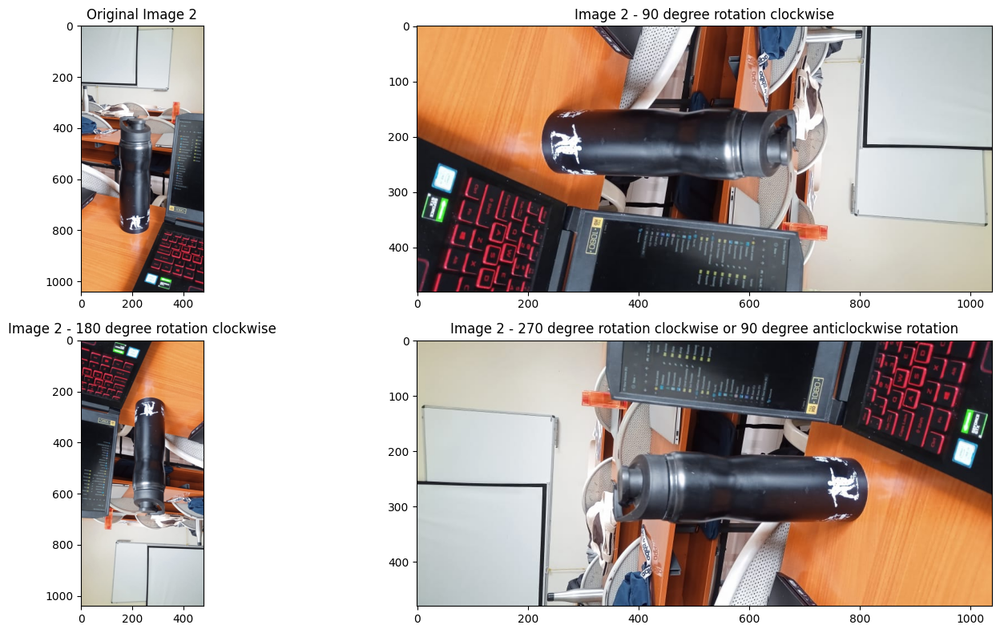

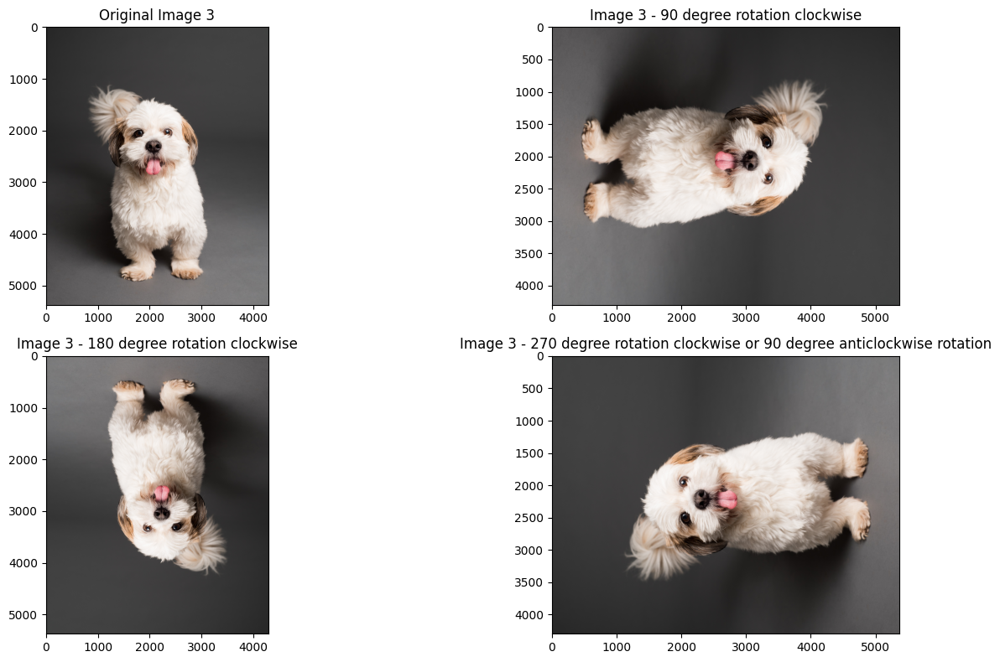

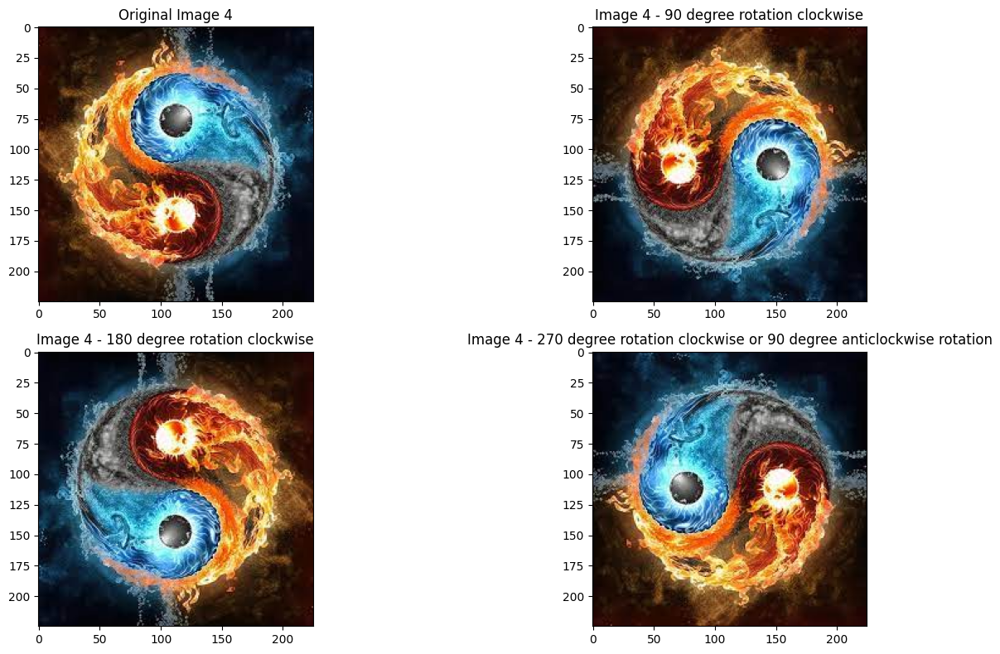

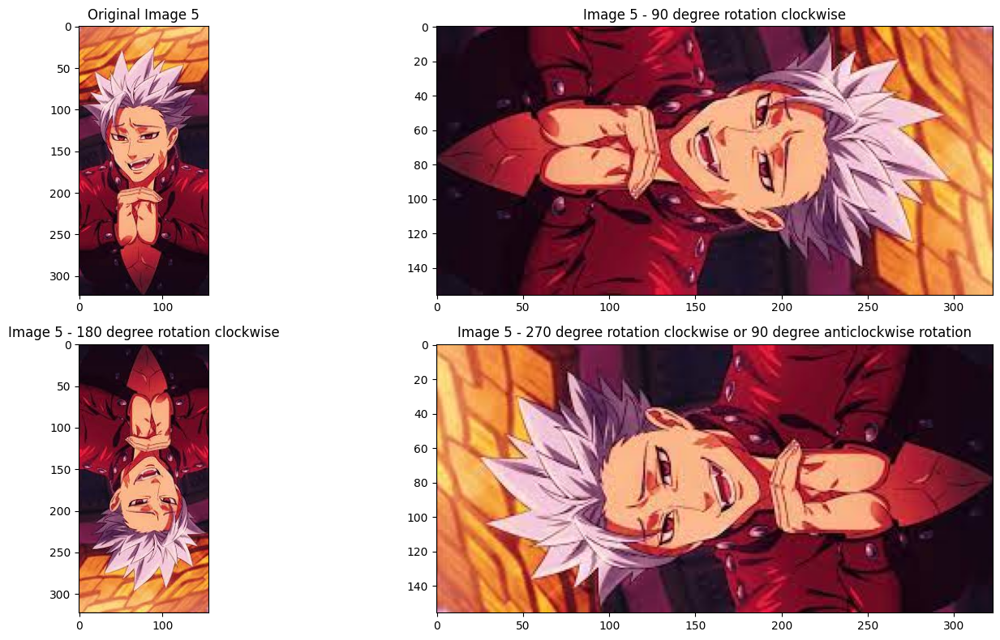

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Function to rotate the image
def rotate_image(image, angle):
    return cv2.rotate(image, angle)


# List of file paths for the images
image_paths = ['/content/ninja.jpg',
    '/content/a.jpeg',
    '/content/dog.jpg',
    '/content/image4.jpg',
    '/content/image5.jpg']

# Create a subplot for each image and its transformation

for i, image_path in enumerate(image_paths):

    plt.figure(figsize=(16, 8))

    # Read the original image
    src = cv2.imread(image_path)

    # Rotate the image
    rotation_90 = rotate_image(src, cv2.ROTATE_90_CLOCKWISE)
    rotation_180 = rotate_image(src, cv2.ROTATE_180)
    rotation_270 = rotate_image(src, cv2.ROTATE_90_COUNTERCLOCKWISE)

    # Display the original and rotated images side by side
    plt.subplot(221)
    plt.imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))
    plt.title(f'Original Image {i+1}')

    plt.subplot(222)
    plt.imshow(cv2.cvtColor(rotation_90, cv2.COLOR_BGR2RGB))
    plt.title(f'Image {i+1} - 90 degree rotation clockwise')

    plt.subplot(223)
    plt.imshow(cv2.cvtColor(rotation_180, cv2.COLOR_BGR2RGB))
    plt.title(f'Image {i+1} - 180 degree rotation clockwise')

    plt.subplot(224)
    plt.imshow(cv2.cvtColor(rotation_270, cv2.COLOR_BGR2RGB))
    plt.title(f'Image {i+1} - 270 degree rotation clockwise or 90 degree anticlockwise rotation')

    plt.tight_layout()
    plt.show()

    # Save the rotated images
    cv2.imwrite(f'rotated_image_{i+1}_90.jpg', rotation_90)
    cv2.imwrite(f'rotated_image_{i+1}_180.jpg', rotation_180)
    cv2.imwrite(f'rotated_image_{i+1}_270.jpg', rotation_270)

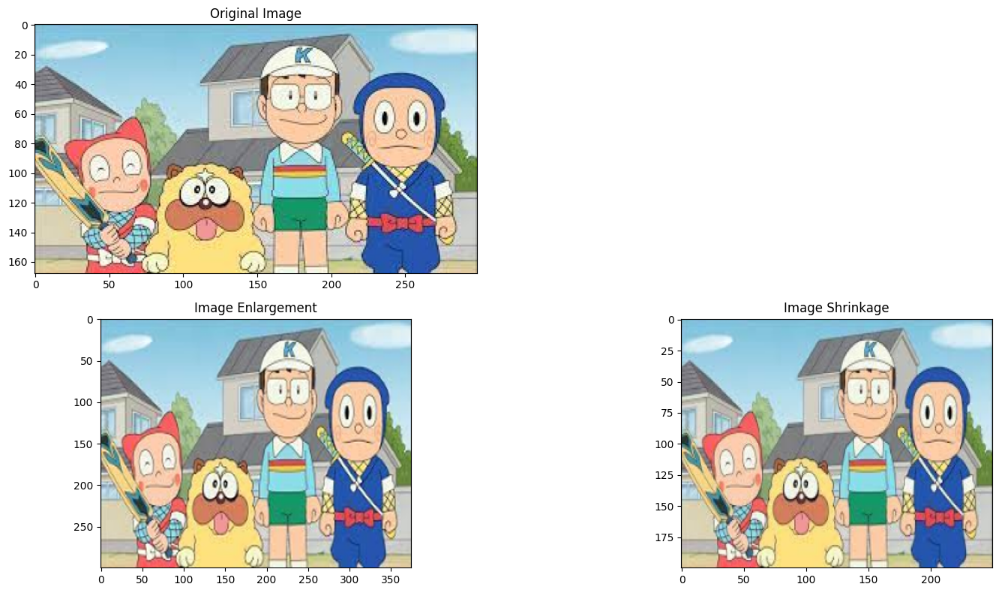

In [ ]:
img = cv2.imread('/content/ninja.jpg')

img_shrinked = cv2.resize(img, (250, 200),
                         interpolation=cv2.INTER_AREA)

img_enlarged = cv2.resize(img_shrinked, None,
                         fx=1.5, fy=1.5,
                         interpolation=cv2.INTER_CUBIC)

plt.figure(figsize=(16, 8))
plt.subplot(221)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.subplot(223)
plt.imshow(cv2.cvtColor(img_enlarged, cv2.COLOR_BGR2RGB))
plt.title('Image Enlargement')


plt.subplot(224)
plt.imshow(cv2.cvtColor(img_shrinked, cv2.COLOR_BGR2RGB))
plt.title('Image Shrinkage')

plt.tight_layout()
plt.show()

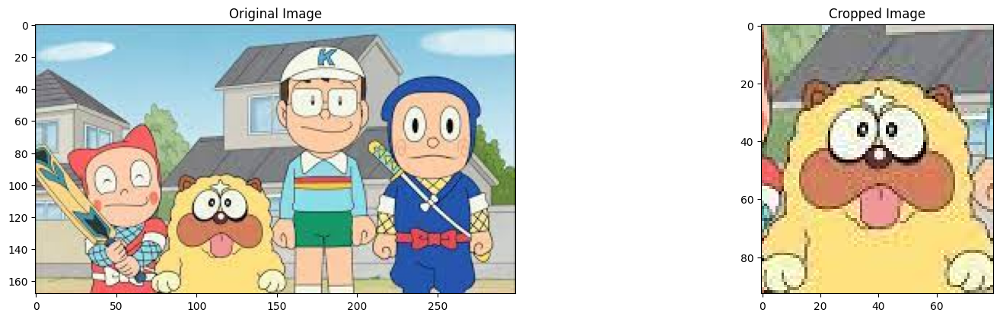

In [ ]:
img = cv2.imread('/content/ninja.jpg')
cropped_img = img[75:180, 75:155]


plt.figure(figsize=(16, 8))
plt.subplot(221)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.subplot(222)
plt.imshow(cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB))
plt.title('Cropped Image')

plt.tight_layout()
plt.show()

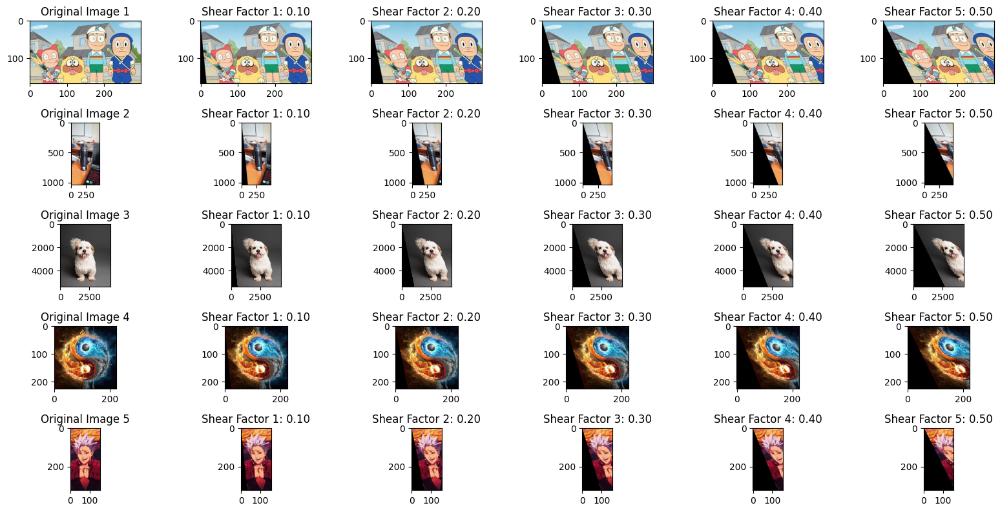

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Function to apply shearing transformation
def apply_shear(image, shear_factor):
    rows, cols, _ = image.shape
    shear_matrix = np.array([[1, shear_factor, 0], [0, 1, 0]], dtype=np.float32)
    sheared_image = cv2.warpAffine(image, shear_matrix, (cols, rows))
    return sheared_image

# List of file paths for the images
image_paths = ['/content/ninja.jpg',
    '/content/a.jpeg',
    '/content/dog.jpg',
    '/content/image4.jpg',
    '/content/image5.jpg']

# Shearing factors for each image (you can customize these values)
shear_factors = [0.1, 0.2, 0.3, 0.4, 0.5]

# Create a subplot for each image and its sheared versions with shear factors
num_images = len(image_paths)
num_shear_factors = len(shear_factors)

# Create one set of subplots
fig, axes = plt.subplots(num_images, num_shear_factors + 1, figsize=(16, 8))

for i, image_path in enumerate(image_paths):
    # Read the original image
    src = cv2.imread(image_path)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title(f'Original Image {i + 1}')

    # Apply and display shearing transformations for each shearing factor
    for j, shear_factor in enumerate(shear_factors):
        sheared_image = apply_shear(src, shear_factor)
        axes[i, j + 1].imshow(cv2.cvtColor(sheared_image, cv2.COLOR_BGR2RGB))
        axes[i, j + 1].set_title(f'Shear Factor {j + 1}: {shear_factor:.2f}')

# Adjust spacing between subplots to remove gaps
plt.tight_layout()

# Show the plots
plt.show()

## **Image Registration and Image Alignment**

### **Photo Images**

In [ ]:
# import the necessary packages
import numpy as np
import imutils
import cv2
from google.colab.patches import cv2_imshow

def align_images(image, template, maxFeatures=500, keepPercent=0.2,debug=False):
  # convert both the input image and template to grayscale
  imageGray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  templateGray = cv2.cvtColor(template, cv2.COLOR_BGR2GRAY)

  # use ORB to detect keypoints and extract (binary) local
  # invariant features
  orb = cv2.ORB_create(maxFeatures)
  (kpsA, descsA) = orb.detectAndCompute(imageGray, None)
  (kpsB, descsB) = orb.detectAndCompute(templateGray, None)

  # match the features
  method = cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING
  matcher = cv2.DescriptorMatcher_create(method)
  matches = matcher.match(descsA, descsB, None)

  # sort the matches by their distance (the smaller the distance,
  # the "more similar" the features are)
  matches = sorted(matches, key=lambda x:x.distance)

  # keep only the top matches
  keep = int(len(matches) * keepPercent)
  matches = matches[:keep]

  # check to see if we should visualize the matched keypoints
  if debug:
    matchedVis = cv2.drawMatches(image, kpsA, template, kpsB,matches, None)
    matchedVis = imutils.resize(matchedVis, width=1000)
    cv2_imshow(matchedVis)
    print("\n")

  # allocate memory for the keypoints (x, y)-coordinates from the
  # top matches -- we'll use these coordinates to compute our
  # homography matrix
  ptsA = np.zeros((len(matches), 2), dtype="float")
  ptsB = np.zeros((len(matches), 2), dtype="float")
  # loop over the top matches
  for (i, m) in enumerate(matches):
    # indicate that the two keypoints in the respective images
    # map to each other
    ptsA[i] = kpsA[m.queryIdx].pt
    ptsB[i] = kpsB[m.trainIdx].pt

  # compute the homography matrix between the two sets of matched points
  (H, mask) = cv2.findHomography(ptsA, ptsB, method=cv2.RANSAC)
  # use the homography matrix to align the images
  (h, w) = template.shape[:2]
  aligned = cv2.warpPerspective(image, H, (w, h))

  # return the aligned image
  return aligned

In [ ]:
# import the necessary packages
import numpy as np
import argparse
import imutils
import cv2
import sys


sys.argv = ["your_script.py", "-i", "/content/rotated_image_2_90.jpg", "-t", "/content/a.jpeg"]

# Construct the argument parser
ap = argparse.ArgumentParser()
ap.add_argument("-i", "--image", required=True, help="/content/rotated_image_2_90.jpg")
ap.add_argument("-t", "--template", required=True, help="/content/a.jpeg")

# Parse the arguments
args = vars(ap.parse_args())

In [ ]:
# load the input image and template from disk
print("[INFO] loading images...")
image = cv2.imread(args["image"])
template = cv2.imread(args["template"])

[INFO] loading images...


[INFO] aligning images...


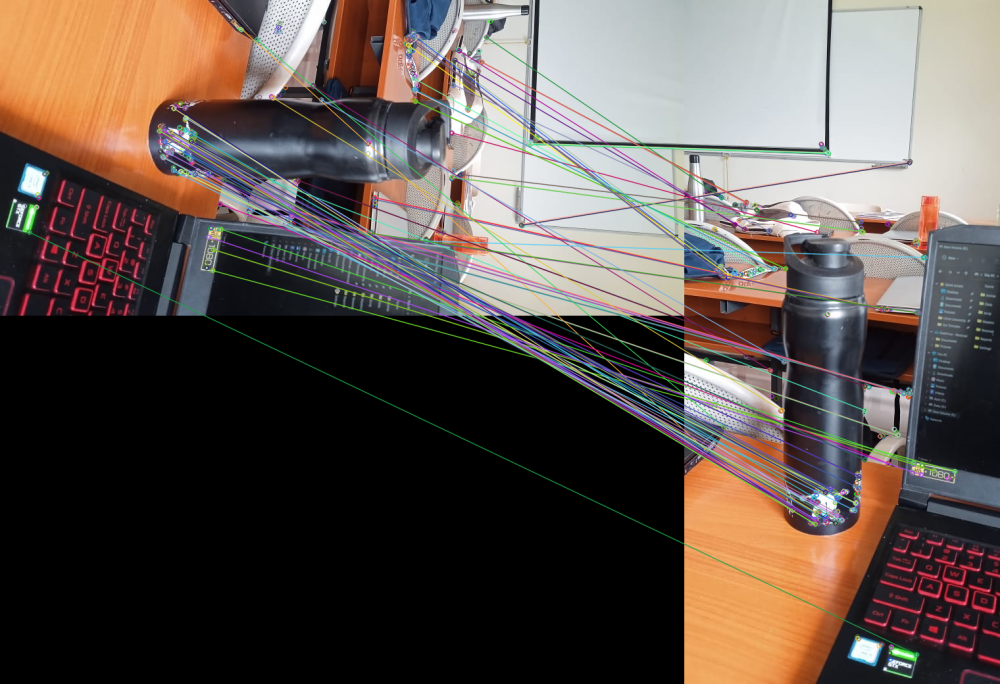

In [ ]:
from google.colab.patches import cv2_imshow
# align the images
print("[INFO] aligning images...")
aligned = align_images(image, template, debug=True)

In [ ]:
# resize both the aligned and template images so we can easily
# visualize them on our screen
aligned = imutils.resize(aligned, width=700)
template = imutils.resize(template, width=700)

In [ ]:
# our first output visualization of the image alignment will be a
# side-by-side comparison of the output aligned image and the
# template
stacked = np.hstack([aligned, template])

In [ ]:
# our second image alignment visualization will be *overlaying* the
# aligned image on the template, that way we can obtain an idea of
# how good our image alignment is
overlay = template.copy()
output = aligned.copy()
cv2.addWeighted(overlay, 0.5, output, 0.5, 0, output)

array([[[160, 160, 150],
        [166, 166, 154],
        [170, 170, 159],
        ...,
        [147, 170, 176],
        [144, 166, 171],
        [139, 161, 166]],

       [[166, 166, 156],
        [172, 172, 162],
        [178, 178, 166],
        ...,
        [157, 182, 187],
        [152, 176, 182],
        [148, 170, 176]],

       [[172, 172, 162],
        [179, 179, 168],
        [184, 184, 172],
        ...,
        [165, 191, 197],
        [160, 186, 191],
        [154, 179, 184]],

       ...,

       [[ 94, 165, 239],
        [ 94, 165, 239],
        [ 94, 165, 239],
        ...,
        [ 39,  31,  36],
        [ 39,  31,  36],
        [ 39,  31,  36]],

       [[ 92, 162, 234],
        [ 92, 162, 234],
        [ 92, 162, 234],
        ...,
        [ 38,  30,  32],
        [ 38,  30,  32],
        [ 38,  30,  32]],

       [[ 90, 158, 228],
        [ 90, 158, 228],
        [ 90, 158, 228],
        ...,
        [ 37,  30,  30],
        [ 37,  30,  30],
        [ 37,  30,  30]]

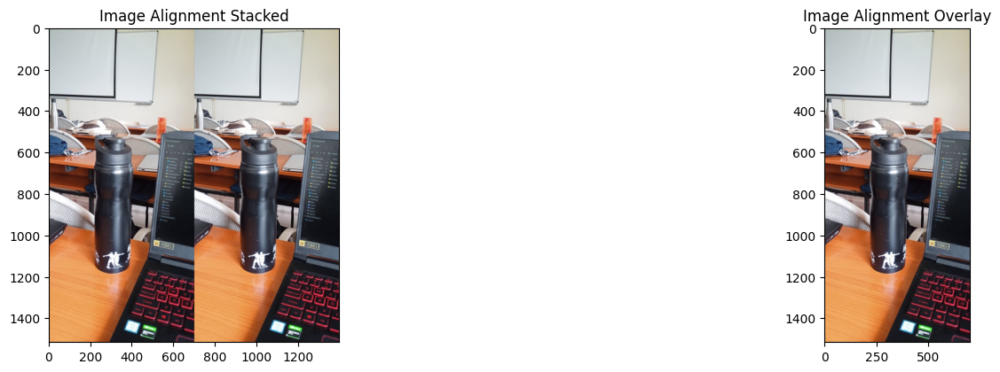

In [ ]:
plt.figure(figsize=(16, 8))
plt.subplot(221)
plt.imshow(cv2.cvtColor(stacked, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Stacked')

plt.subplot(222)
plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Overlay')

plt.tight_layout()
plt.show()

[INFO] loading images...
[INFO] aligning images...


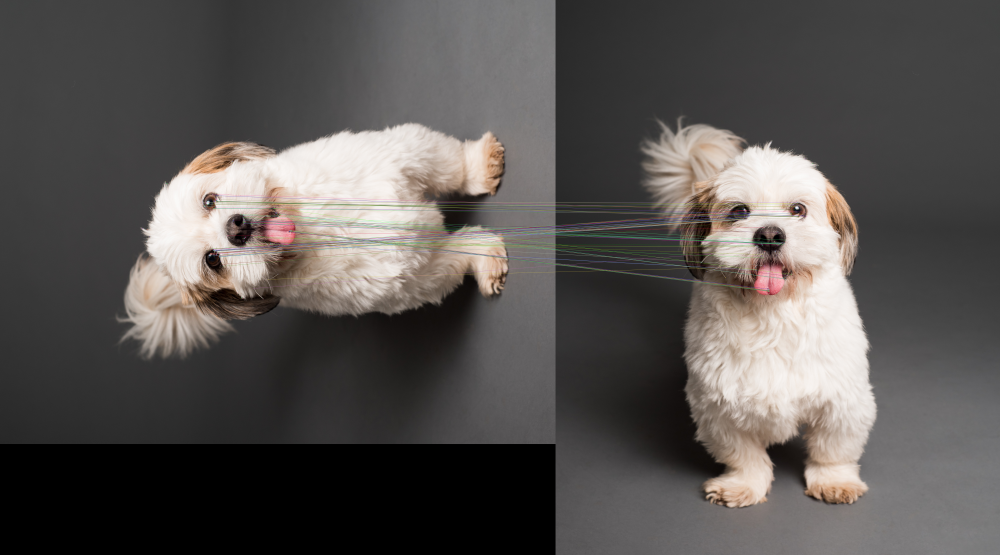

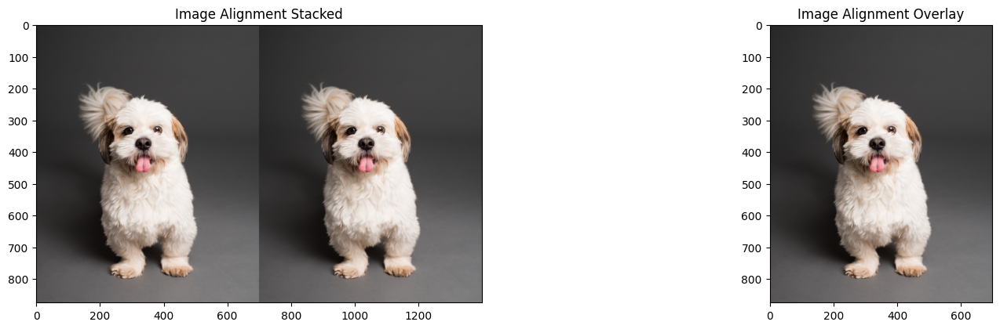

In [ ]:
# import the necessary packages
import numpy as np
import argparse
import imutils
import cv2
import sys


sys.argv = ["your_script.py", "-i", "/content/rotated_image_3_270.jpg", "-t", "/content/dog.jpg"]

# Construct the argument parser
ap = argparse.ArgumentParser()
ap.add_argument("-i", "--image", required=True, help="/content/rotated_image_3_270.jpg")
ap.add_argument("-t", "--template", required=True, help="/content/dog.jpg")

# Parse the arguments
args = vars(ap.parse_args())

# load the input image and template from disk
print("[INFO] loading images...")
image = cv2.imread(args["image"])
template = cv2.imread(args["template"])

from google.colab.patches import cv2_imshow
# align the images
print("[INFO] aligning images...")
aligned = align_images(image, template, debug=True)

# resize both the aligned and template images so we can easily
# visualize them on our screen
aligned = imutils.resize(aligned, width=700)
template = imutils.resize(template, width=700)


# our first output visualization of the image alignment will be a
# side-by-side comparison of the output aligned image and the
# template
stacked = np.hstack([aligned, template])

# our second image alignment visualization will be *overlaying* the
# aligned image on the template, that way we can obtain an idea of
# how good our image alignment is
overlay = template.copy()
output = aligned.copy()
cv2.addWeighted(overlay, 0.5, output, 0.5, 0, output)

plt.figure(figsize=(16, 8))
plt.subplot(221)
plt.imshow(cv2.cvtColor(stacked, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Stacked')

plt.subplot(222)
plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Overlay')

plt.tight_layout()
plt.show()

[INFO] loading images...
[INFO] aligning images...


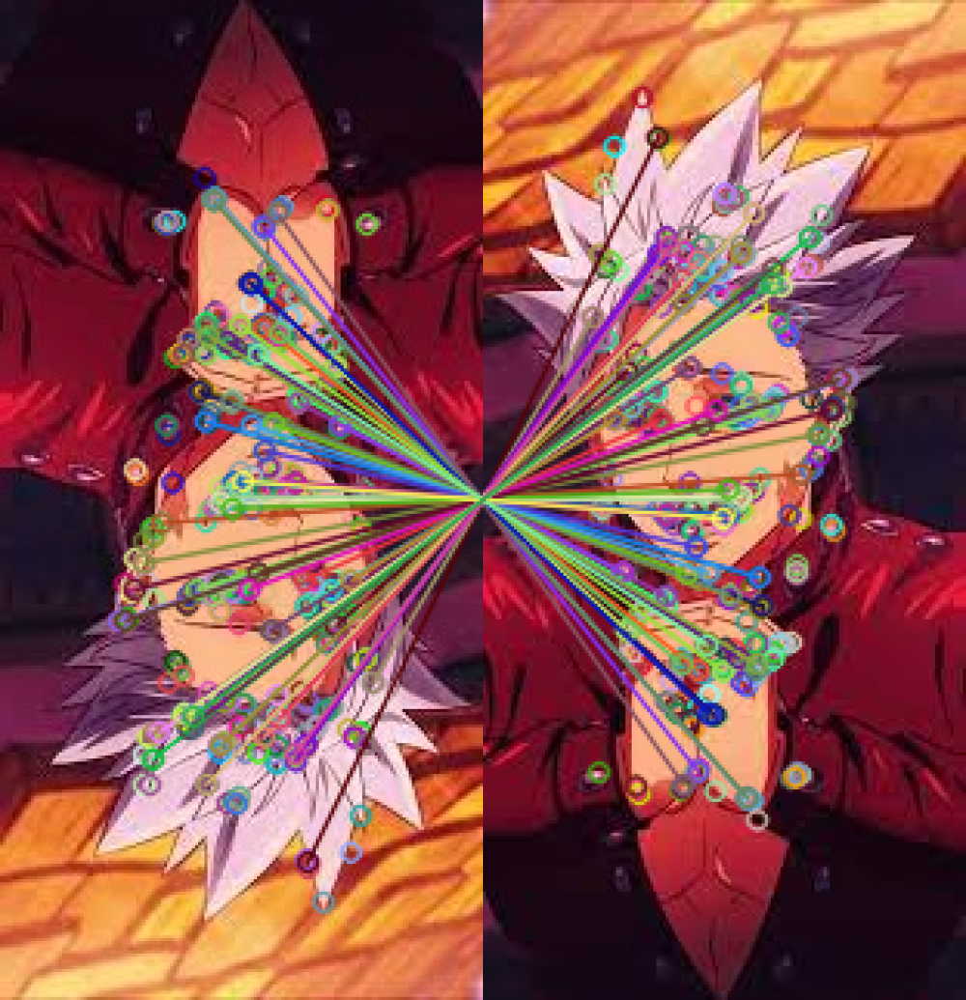

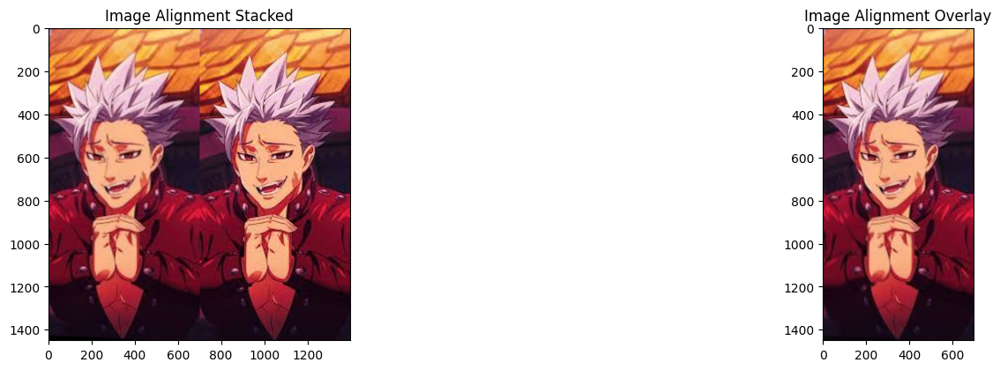

In [ ]:
# import the necessary packages
import numpy as np
import argparse
import imutils
import cv2
import sys


sys.argv = ["your_script.py", "-i", "/content/rotated_image_5_180.jpg", "-t", "/content/image5.jpg"]

# Construct the argument parser
ap = argparse.ArgumentParser()
ap.add_argument("-i", "--image", required=True, help="/content/rotated_image_5_180.jpg")
ap.add_argument("-t", "--template", required=True, help="/content/image5.jpg")

# Parse the arguments
args = vars(ap.parse_args())

# load the input image and template from disk
print("[INFO] loading images...")
image = cv2.imread(args["image"])
template = cv2.imread(args["template"])

from google.colab.patches import cv2_imshow
# align the images
print("[INFO] aligning images...")
aligned = align_images(image, template, debug=True)

# resize both the aligned and template images so we can easily
# visualize them on our screen
aligned = imutils.resize(aligned, width=700)
template = imutils.resize(template, width=700)


# our first output visualization of the image alignment will be a
# side-by-side comparison of the output aligned image and the
# template
stacked = np.hstack([aligned, template])

# our second image alignment visualization will be *overlaying* the
# aligned image on the template, that way we can obtain an idea of
# how good our image alignment is
overlay = template.copy()
output = aligned.copy()
cv2.addWeighted(overlay, 0.5, output, 0.5, 0, output)

plt.figure(figsize=(16, 8))
plt.subplot(221)
plt.imshow(cv2.cvtColor(stacked, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Stacked')

plt.subplot(222)
plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Overlay')

plt.tight_layout()
plt.show()

[INFO] loading images...
[INFO] aligning images...


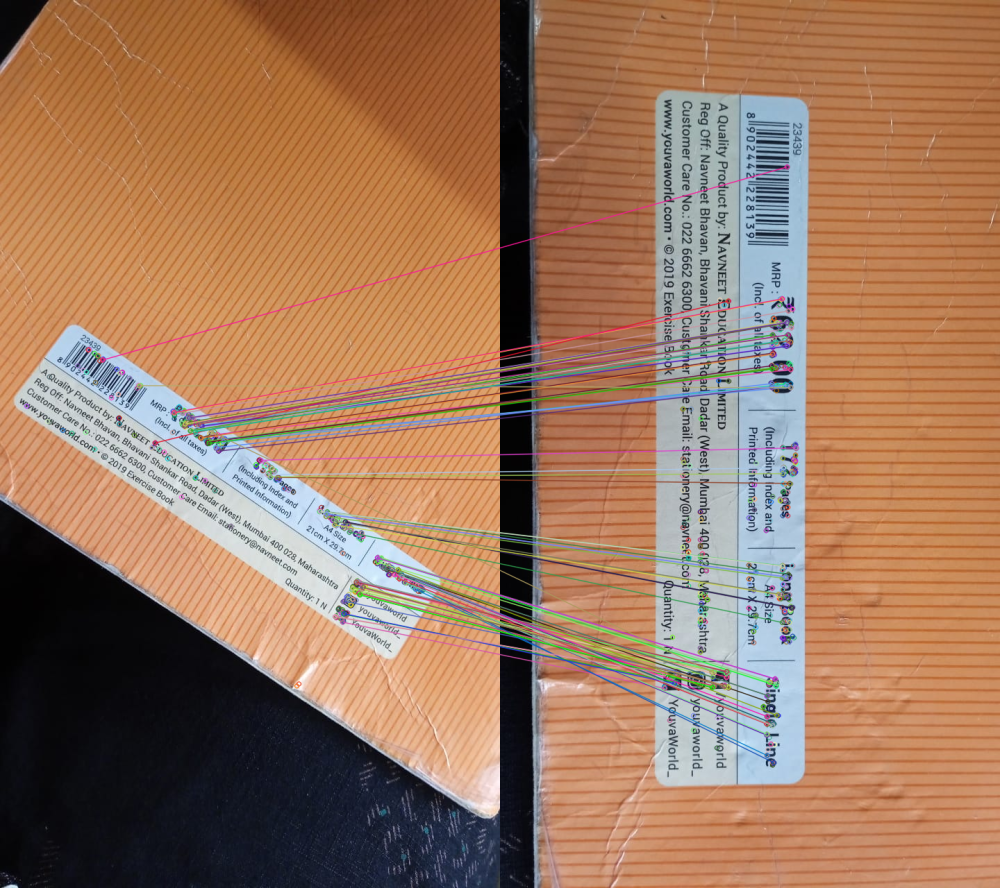

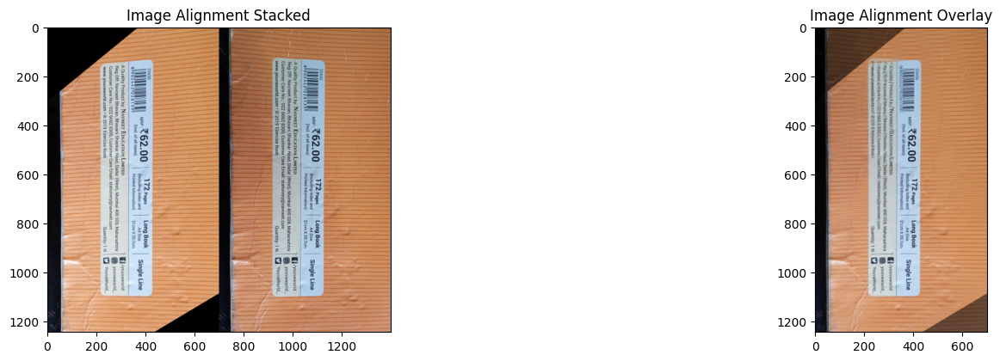

In [ ]:
# import the necessary packages
import numpy as np
import argparse
import imutils
import cv2
import sys


sys.argv = ["your_script.py", "-i", "/content/dif.jpeg", "-t", "/content/org.jpeg"]

# Construct the argument parser
ap = argparse.ArgumentParser()
ap.add_argument("-i", "--image", required=True, help="/content/dif.jpeg")
ap.add_argument("-t", "--template", required=True, help="/content/org.jpeg")

# Parse the arguments
args = vars(ap.parse_args())

# load the input image and template from disk
print("[INFO] loading images...")
image = cv2.imread(args["image"])
template = cv2.imread(args["template"])

from google.colab.patches import cv2_imshow
# align the images
print("[INFO] aligning images...")
aligned = align_images(image, template, debug=True)

# resize both the aligned and template images so we can easily
# visualize them on our screen
aligned = imutils.resize(aligned, width=700)
template = imutils.resize(template, width=700)


# our first output visualization of the image alignment will be a
# side-by-side comparison of the output aligned image and the
# template
stacked = np.hstack([aligned, template])

# our second image alignment visualization will be *overlaying* the
# aligned image on the template, that way we can obtain an idea of
# how good our image alignment is
overlay = template.copy()
output = aligned.copy()
cv2.addWeighted(overlay, 0.5, output, 0.5, 0, output)

plt.figure(figsize=(16, 8))
plt.subplot(221)
plt.imshow(cv2.cvtColor(stacked, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Stacked')

plt.subplot(222)
plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Overlay')

plt.tight_layout()
plt.show()

[INFO] loading images...
[INFO] aligning images...


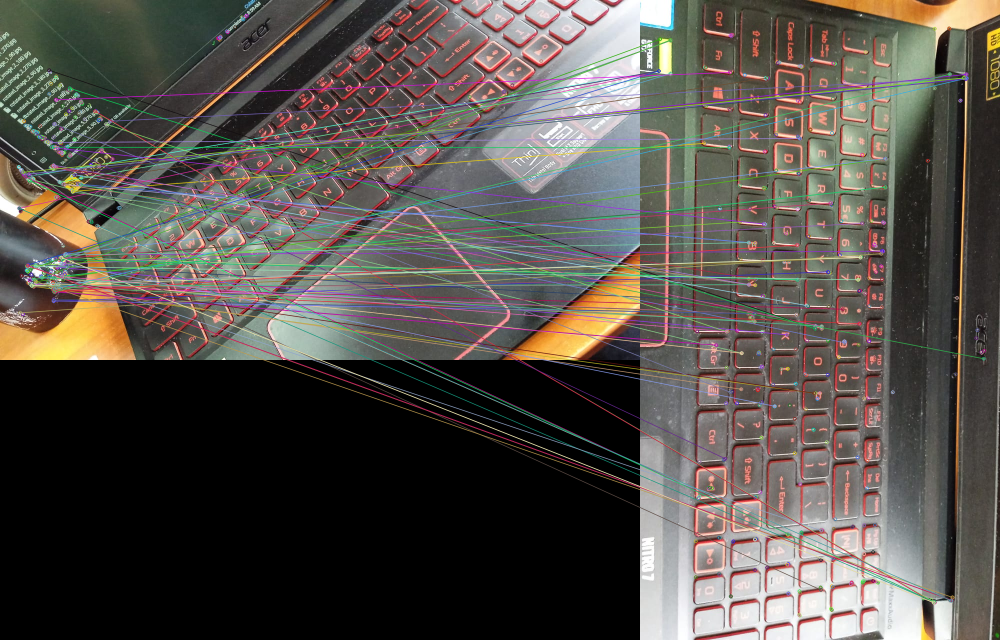

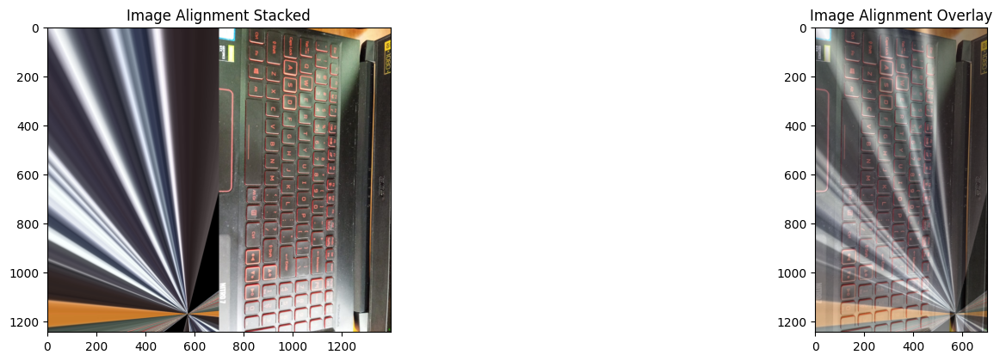

In [ ]:
# import the necessary packages
import numpy as np
import argparse
import imutils
import cv2
import sys


sys.argv = ["your_script.py", "-i", "/content/laptem.jpeg", "-t", "/content/laporg.jpeg"]

# Construct the argument parser
ap = argparse.ArgumentParser()
ap.add_argument("-i", "--image", required=True, help="/content/laptem.jpeg")
ap.add_argument("-t", "--template", required=True, help="/content/laporg.jpeg")

# Parse the arguments
args = vars(ap.parse_args())

# load the input image and template from disk
print("[INFO] loading images...")
image = cv2.imread(args["image"])
template = cv2.imread(args["template"])

from google.colab.patches import cv2_imshow
# align the images
print("[INFO] aligning images...")
aligned = align_images(image, template, debug=True)

# resize both the aligned and template images so we can easily
# visualize them on our screen
aligned = imutils.resize(aligned, width=700)
template = imutils.resize(template, width=700)


# our first output visualization of the image alignment will be a
# side-by-side comparison of the output aligned image and the
# template
stacked = np.hstack([aligned, template])

# our second image alignment visualization will be *overlaying* the
# aligned image on the template, that way we can obtain an idea of
# how good our image alignment is
overlay = template.copy()
output = aligned.copy()
cv2.addWeighted(overlay, 0.5, output, 0.5, 0, output)

plt.figure(figsize=(16, 8))
plt.subplot(221)
plt.imshow(cv2.cvtColor(stacked, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Stacked')

plt.subplot(222)
plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Overlay')

plt.tight_layout()
plt.show()

### **Medical Images**

[INFO] loading images...
[INFO] aligning images...


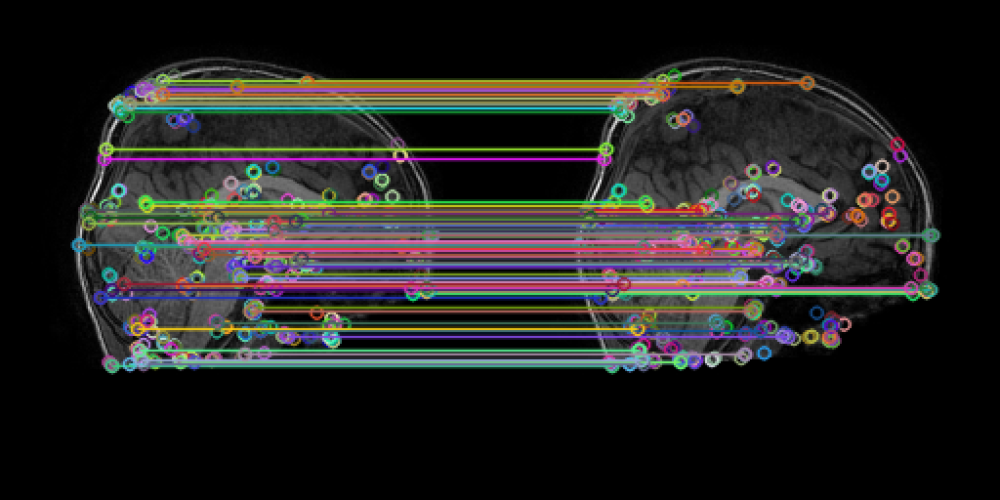

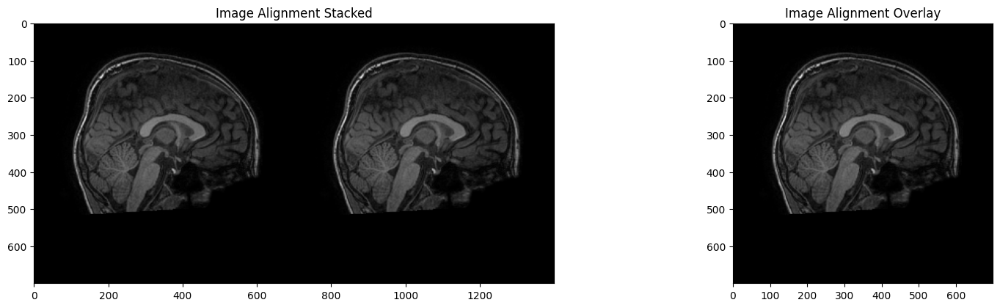

In [ ]:
# import the necessary packages
import numpy as np
import argparse
import imutils
import cv2
import sys


sys.argv = ["your_script.py", "-i", "/content/qc_66.jpg", "-t", "/content/qc_t_66.jpg"]

# Construct the argument parser
ap = argparse.ArgumentParser()
ap.add_argument("-i", "--image", required=True, help="/content/qc_66.jpg")
ap.add_argument("-t", "--template", required=True, help="/content/qc_t_66.jpg")

# Parse the arguments
args = vars(ap.parse_args())

# load the input image and template from disk
print("[INFO] loading images...")
image = cv2.imread(args["image"])
template = cv2.imread(args["template"])

from google.colab.patches import cv2_imshow
# align the images
print("[INFO] aligning images...")
aligned = align_images(image, template, debug=True)

# resize both the aligned and template images so we can easily
# visualize them on our screen
aligned = imutils.resize(aligned, width=700)
template = imutils.resize(template, width=700)


# our first output visualization of the image alignment will be a
# side-by-side comparison of the output aligned image and the
# template
stacked = np.hstack([aligned, template])

# our second image alignment visualization will be *overlaying* the
# aligned image on the template, that way we can obtain an idea of
# how good our image alignment is
overlay = template.copy()
output = aligned.copy()
cv2.addWeighted(overlay, 0.5, output, 0.5, 0, output)

plt.figure(figsize=(16, 8))
plt.subplot(221)
plt.imshow(cv2.cvtColor(stacked, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Stacked')

plt.subplot(222)
plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Overlay')

plt.tight_layout()
plt.show()

[INFO] loading images...
[INFO] aligning images...


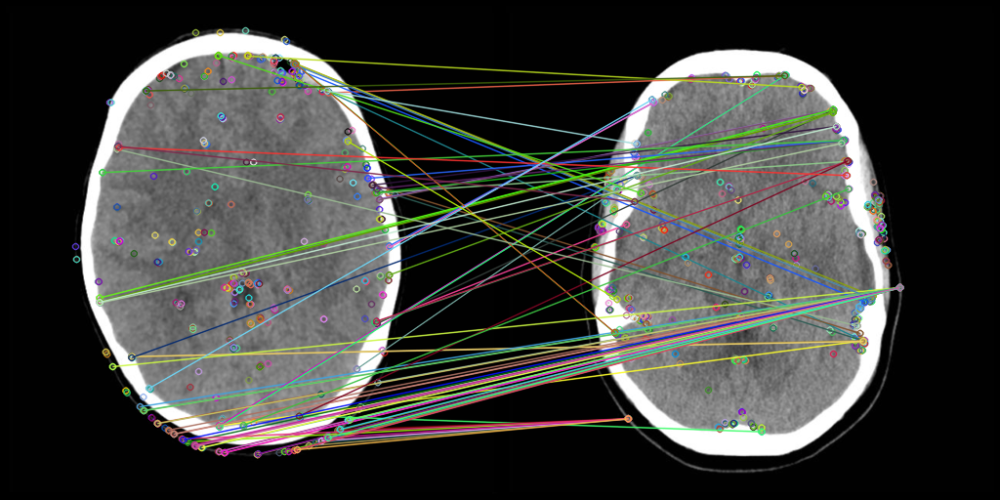

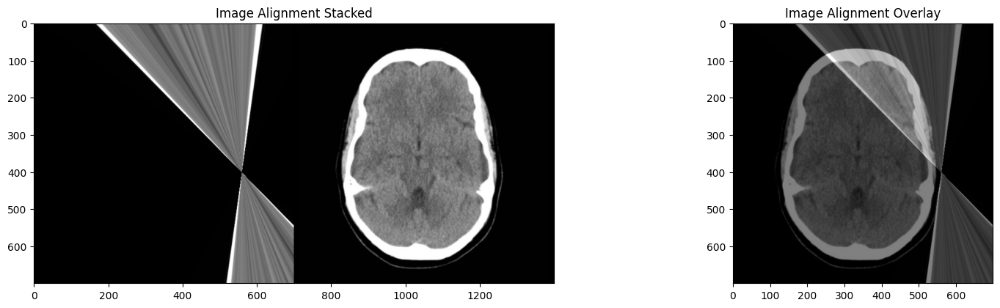

In [ ]:
# import the necessary packages
import numpy as np
import argparse
import imutils
import cv2
import sys


sys.argv = ["your_script.py", "-i", "/content/ct710.png", "-t", "/content/ct77.png"]

# Construct the argument parser
ap = argparse.ArgumentParser()
ap.add_argument("-i", "--image", required=True, help="/content/ct710.png")
ap.add_argument("-t", "--template", required=True, help="/content/ct77.png")

# Parse the arguments
args = vars(ap.parse_args())

# load the input image and template from disk
print("[INFO] loading images...")
image = cv2.imread(args["image"])
template = cv2.imread(args["template"])

from google.colab.patches import cv2_imshow
# align the images
print("[INFO] aligning images...")
aligned = align_images(image, template, debug=True)

# resize both the aligned and template images so we can easily
# visualize them on our screen
aligned = imutils.resize(aligned, width=700)
template = imutils.resize(template, width=700)


# our first output visualization of the image alignment will be a
# side-by-side comparison of the output aligned image and the
# template
stacked = np.hstack([aligned, template])

# our second image alignment visualization will be *overlaying* the
# aligned image on the template, that way we can obtain an idea of
# how good our image alignment is
overlay = template.copy()
output = aligned.copy()
cv2.addWeighted(overlay, 0.5, output, 0.5, 0, output)

plt.figure(figsize=(16, 8))
plt.subplot(221)
plt.imshow(cv2.cvtColor(stacked, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Stacked')

plt.subplot(222)
plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
plt.title('Image Alignment Overlay')

plt.tight_layout()
plt.show()